In [1]:
%run ../common-imports.ipynb

This is a classic dataset about various wines and the sources they come from. There are specifically three sources.

## Lab Goals

* will explore this data, observe its statistical characteristics, visualize it.
* will build classifiers to predict the sources of the various wines.


## Load and explore the data

Since this dataset is built into the `sklearn` library, will load it directly from there.

In [2]:
from sklearn.datasets import load_wine
X, y= load_wine(return_X_y=True, as_frame=True)

### Descriptive statistics


In [3]:
X.describe(include='all').transpose()

,count,mean,std,min,25%,50%,75%,max
alcohol,178.0,13.000618,0.811827,11.03,12.3625,13.050,13.6775,14.83
malic_acid,178.0,2.336348,1.117146,0.74,1.6025,1.865,3.0825,5.80
ash,178.0,2.366517,0.274344,1.36,2.2100,2.360,2.5575,3.23
alcalinity_of_ash,178.0,19.494944,3.339564,10.60,17.2000,19.500,21.5000,30.00
magnesium,178.0,99.741573,14.282484,70.00,88.0000,98.000,107.0000,162.00
total_phenols,178.0,2.295112,0.625851,0.98,1.7425,2.355,2.8000,3.88
flavanoids,178.0,2.029270,0.998859,0.34,1.2050,2.135,2.8750,5.08
nonflavanoid_phenols,178.0,0.361854,0.124453,0.13,0.2700,0.340,0.4375,0.66
proanthocyanins,178.0,1.590899,0.572359,0.41,1.2500,1.555,1.9500,3.58
color_intensity,178.0,5.058090,2.318286,1.28,3.2200,4.690,6.2000,13.00


In [4]:
y.describe()

count    178.000000
mean       0.938202
std        0.775035
min        0.000000
25%        0.000000
50%        1.000000
75%        2.000000
max        2.000000
Name: target, dtype: float64

In [5]:
X.sample(5).transpose()

,19,45,140,30,67
alcohol,13.64,14.21,12.93,13.73,12.37
malic_acid,3.10,4.04,2.81,1.50,1.17
ash,2.56,2.44,2.70,2.70,1.92
alcalinity_of_ash,15.20,18.90,21.00,22.50,19.60
magnesium,116.00,111.00,96.00,101.00,78.00
total_phenols,2.70,2.85,1.54,3.00,2.11
flavanoids,3.03,2.65,0.50,3.25,2.00
nonflavanoid_phenols,0.17,0.30,0.53,0.29,0.27
proanthocyanins,1.66,1.25,0.75,2.38,1.04
color_intensity,5.10,5.24,4.60,5.70,4.68


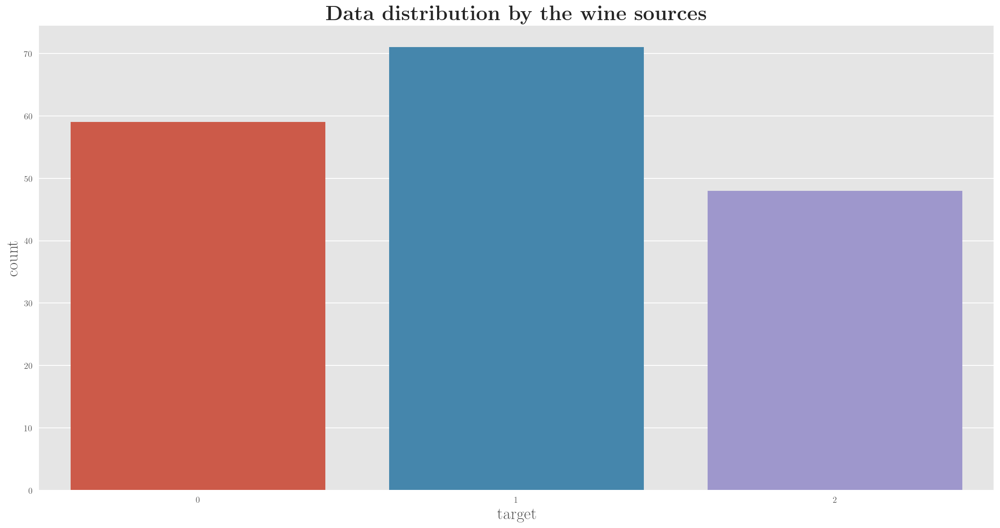

In [6]:
sns.countplot(y);
plt.title(r"\textbf{Data distribution by the wine sources}", size=24);


#### Missing Values Analysis


In [7]:
X.isnull().sum()

alcohol                         0
malic_acid                      0
ash                             0
alcalinity_of_ash               0
magnesium                       0
total_phenols                   0
flavanoids                      0
nonflavanoid_phenols            0
proanthocyanins                 0
color_intensity                 0
hue                             0
od280/od315_of_diluted_wines    0
proline                         0
dtype: int64

 From the above results, it appears that there are no missing values at all. Therefore, we don't need to worry about addressing this issue.

#### Pandas Profiling



In [8]:
# Uncomment this to run it.
rc ('text', usetex=False) # column names have underscores, that will trip TeX
#X.profile_report()

## Data Visualization

### Plotting using matplotlib

Let us first visualize a scatter plot of the data and look at the histogram of the features. Finally, let us pull of this together with a kernel density plot, into a single plot with subplots.

Overall, looking at the plots, one is encouraged to believe that a simple linear regression (OLS) may work well for this data. Let us see if this is true in the next section.

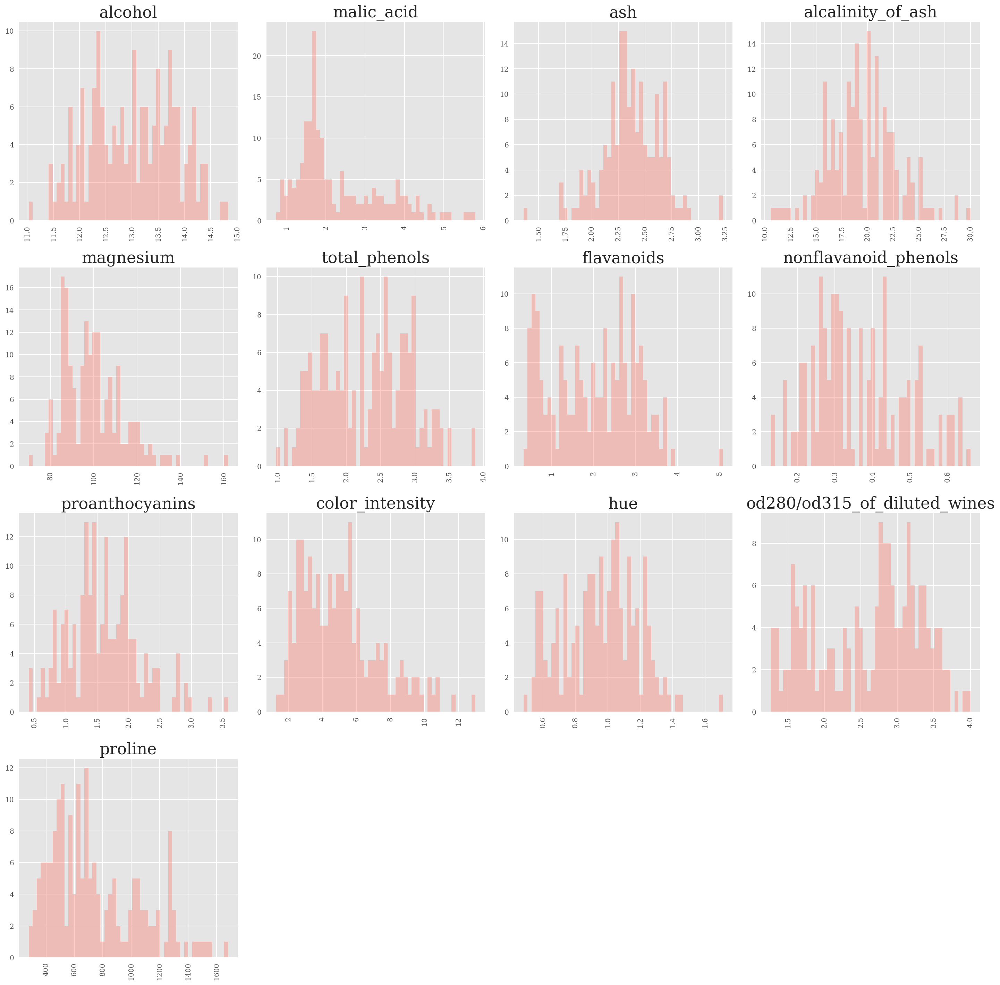

In [9]:
X.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20));
plt.tight_layout()

### Violin-plot and box-plot of features by diagnosis

Considering that we have quite a few predictors, let us first start by looking at their data distribution plots as violin-plots and box-plots.

In [10]:
rc('text', usetex=False)
features = X.columns.tolist()
data = X.copy()
data['target']=y.astype(str)
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
alcohol,178.0,NaN,NaN,NaN,13.000618,0.811827,11.03,12.3625,13.05,13.6775,14.83
malic_acid,178.0,NaN,NaN,NaN,2.336348,1.117146,0.74,1.6025,1.865,3.0825,5.8
ash,178.0,NaN,NaN,NaN,2.366517,0.274344,1.36,2.21,2.36,2.5575,3.23
alcalinity_of_ash,178.0,NaN,NaN,NaN,19.494944,3.339564,10.6,17.2,19.5,21.5,30.0
magnesium,178.0,NaN,NaN,NaN,99.741573,14.282484,70.0,88.0,98.0,107.0,162.0
total_phenols,178.0,NaN,NaN,NaN,2.295112,0.625851,0.98,1.7425,2.355,2.8,3.88
flavanoids,178.0,NaN,NaN,NaN,2.02927,0.998859,0.34,1.205,2.135,2.875,5.08
nonflavanoid_phenols,178.0,NaN,NaN,NaN,0.361854,0.124453,0.13,0.27,0.34,0.4375,0.66
proanthocyanins,178.0,NaN,NaN,NaN,1.590899,0.572359,0.41,1.25,1.555,1.95,3.58
color_intensity,178.0,NaN,NaN,NaN,5.05809,2.318286,1.28,3.22,4.69,6.2,13.0


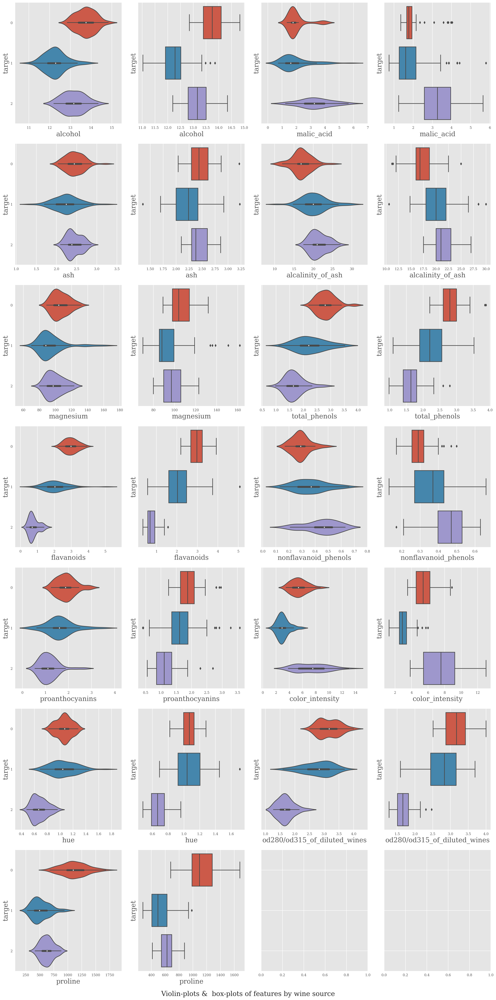

In [11]:
# Because there are 15 numerical features
fig, axes = plt.subplots(7,4, sharey=True, figsize=(20, 40));
for i in range(len(features)):
    row = int(i/2)
    col = 0 if i %2 == 0 else 2
    
    sns.violinplot(  y    = 'target', 
                     x    = features[i], 
                     data = data,ax=axes[row, col], figsize=(5,5));
    sns.boxplot   (  y    = 'target', 
                     x    = features[i], 
                     data = data,ax=axes[row, col+1]);
    
fig.suptitle('Violin-plots &  box-plots of features by wine source', y=0);
plt.tight_layout()

From the above histograms, violin-plots and box-plots, we notice that some of the features have moderate skew, such as `proline` and `malic_acid`. However, none of them have extreme skewness. So we will first try to model without a power-transformation of the data.

Likewise, notice the presence of outliers for `proanthocyanins`, `magnesium`, `malic_acid`, etc. It may be necessary to filter out the outliers, in case the linear models are adversely affected.

## Correlations

Let us now study the correlation between features. Recall that it is generally good indication to observe strong correlation between the target variable (here, `target`) and the predictions. However, linear models are adversely affected if there is a present of strong correlation among the predictors, i.e. multicollinearity.

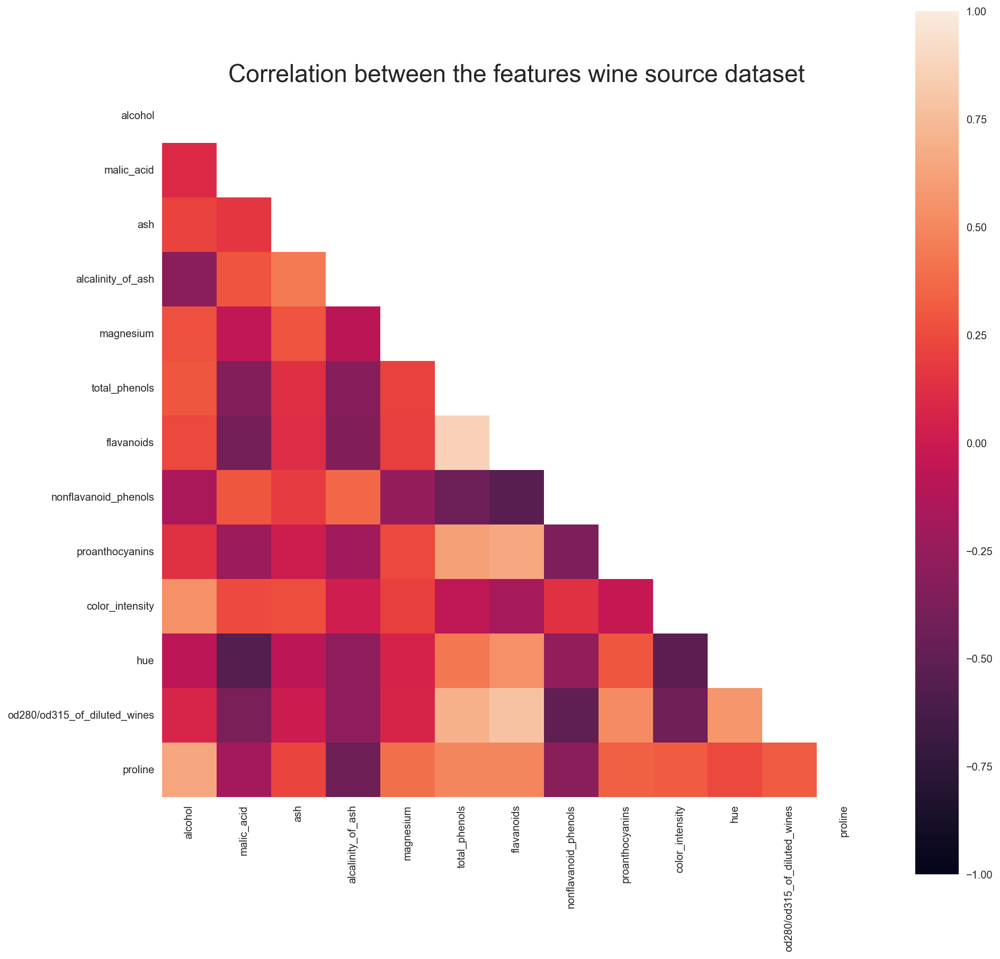

In [12]:
rc('text', usetex=False)
corr = data.corr()
import numpy as np
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15, 15))
    ax = sns.heatmap(corr, mask=mask, vmax=1, vmin=-1, square=True)

    
plt.title(r"Correlation between the features wine source dataset");

In [13]:
pd.options.display.float_format = '${:,.2f}'.format
format_vertical_headers(corr)\
.format("{:.2f}")\
.applymap(lambda x: 'background-color : yellow' if x>=0.85 else '')

,alcohol,malic_acid,ash,alcalinity_of_ash,magnesium,total_phenols,flavanoids,nonflavanoid_phenols,proanthocyanins,color_intensity,hue,od280/od315_of_diluted_wines,proline
alcohol,1.00,0.09,0.21,-0.31,0.27,0.29,0.24,-0.16,0.14,0.55,-0.07,0.07,0.64
malic_acid,0.09,1.00,0.16,0.29,-0.05,-0.34,-0.41,0.29,-0.22,0.25,-0.56,-0.37,-0.19
ash,0.21,0.16,1.00,0.44,0.29,0.13,0.12,0.19,0.01,0.26,-0.07,0.00,0.22
alcalinity_of_ash,-0.31,0.29,0.44,1.00,-0.08,-0.32,-0.35,0.36,-0.20,0.02,-0.27,-0.28,-0.44
magnesium,0.27,-0.05,0.29,-0.08,1.00,0.21,0.20,-0.26,0.24,0.20,0.06,0.07,0.39
total_phenols,0.29,-0.34,0.13,-0.32,0.21,1.00,0.86,-0.45,0.61,-0.06,0.43,0.70,0.50
flavanoids,0.24,-0.41,0.12,-0.35,0.20,0.86,1.00,-0.54,0.65,-0.17,0.54,0.79,0.49
nonflavanoid_phenols,-0.16,0.29,0.19,0.36,-0.26,-0.45,-0.54,1.00,-0.37,0.14,-0.26,-0.50,-0.31
proanthocyanins,0.14,-0.22,0.01,-0.20,0.24,0.61,0.65,-0.37,1.00,-0.03,0.30,0.52,0.33
color_intensity,0.55,0.25,0.26,0.02,0.20,-0.06,-0.17,0.14,-0.03,1.00,-0.52,-0.43,0.32


In the above, the significant correlations above 0.85 have been highlighted. Clearly, there are no significant correlations, except for the correlation between `flavanoids` and `total_phenols`. So it is likely that we will not suffer from adverse multicollinearity effects.

In [14]:
g = sns.pairplot(data, diag_kind='kde', 
                   plot_kws = { 'alpha': 0.20, 's': 30, 'edgecolor': 'k',  }, 
                   size=5, hue='target');
g.map_diag(sns.kdeplot,shade=True);
g.map_upper(plt.scatter,   alpha=0.5);
g.map_lower(sns.kdeplot, shade=False, shade_lowest=False, cbar=True);

plt.tight_layout()

## Classifiers

Let us now build a few classifier models and see how well they work. As is our practice, we will start standardizing the data. Thereafter, we will start our predictive modeling with a dummy classifier, to set a baseline for performance. Then, as we build other models, we will compare their performance to the dummy classifier to see if they provide any prediction "lift".


### Data preparation for modeling


In [15]:
scaler = StandardScaler()
array = scaler.fit_transform(X)
X_scaled = pd.DataFrame(columns=X.columns, data=array)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, random_state=0)

### Dummy Classifier

In [16]:
classifier = DummyClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
confusion_matrix_ = confusion_matrix(y_test, y_pred)
print(confusion_matrix_)
print(classification_report(y_test, y_pred))

[[ 0 16  0]
 [ 0 21  0]
 [ 0  8  0]]
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        16
           1       0.47      1.00      0.64        21
           2       0.00      0.00      0.00         8

    accuracy                           0.47        45
   macro avg       0.16      0.33      0.21        45
weighted avg       0.22      0.47      0.30        45



### Multivariate Logistic Regression Classifier

Let us now attempt to model this data with a logistic regression classifier, on the hypothesis that it may be a linear dataset.

Recalling our observation that features like the `area_mean` appeared to provide a visual separation between the target class in the boxplots, let us first begin with a simple univariate logistic classifier

In [17]:
classifier =  LogisticRegression(solver='newton-cg')
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)

#### Model diagnostics

In [18]:
confusion_matrix_ = confusion_matrix(y_test, y_pred)
print(confusion_matrix_)

[[16  0  0]
 [ 0 21  0]
 [ 0  0  8]]


In [19]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        16
           1       1.00      1.00      1.00        21
           2       1.00      1.00      1.00         8

    accuracy                           1.00        45
   macro avg       1.00      1.00      1.00        45
weighted avg       1.00      1.00      1.00        45



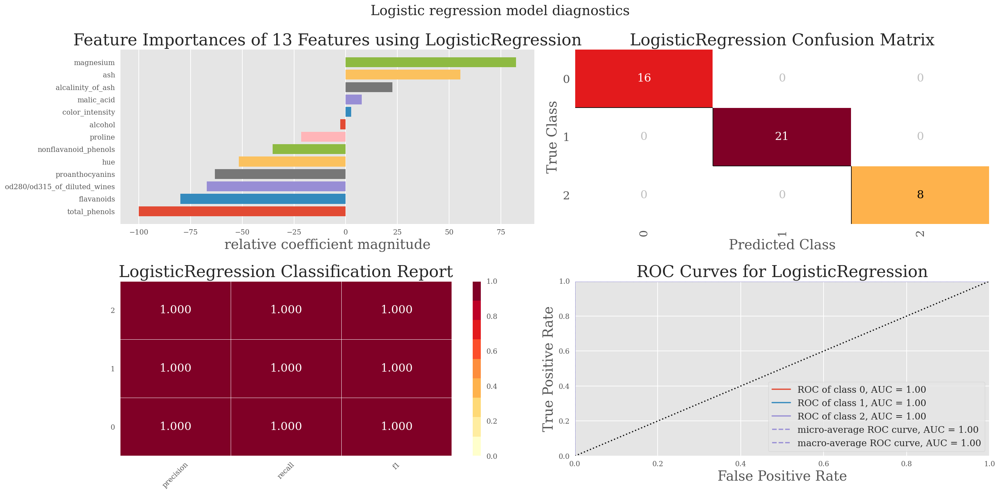

In [20]:
rc('text', usetex=False)
fig, axes = plt.subplots(2, 2)
#plt.figure(figsize=(20,20))
model = classifier
visualgrid = [
    FeatureImportances(model, ax=axes[0][0]),
    ConfusionMatrix(model, ax=axes[0][1], pos_label='M'),
    ClassificationReport(model, ax=axes[1][0], pos_label='M'),
    ROCAUC(model, classes = ['0', '1', '2'], ax=axes[1][1], pos_label='M'),
]

for viz in visualgrid:
    viz.fit(X_train, y_train,)
    viz.score(X_test, y_test,)
    viz.finalize()

plt.suptitle(r'Logistic regression model diagnostics');
plt.tight_layout();

### Feature Importances

Logistic regression is a linear model; with standardized data, the magnitude of the coefficients gives a sense of the relative feature importance.

In [21]:
importances = {}

# normalize coefficients
total = sum([abs(x) for x in classifier.coef_[0]])

normed = [abs(x)/total for x in classifier.coef_[0]]


for k, v in zip(X_scaled.columns, normed):
    importances[k] = v

relative_imp = {k: v for k, v in sorted(importances.items(), key=lambda item: item[1], reverse=True)}

keys =[]
values = []

for k, v in relative_imp.items():
    keys.append(k)
    values.append(v*100)

df = pd.DataFrame(data={'feature': keys, 'important (%)': values})
df

,feature,important (%)
0,proline,$18.56
1,alcalinity_of_ash,$14.33
2,flavanoids,$13.93
3,alcohol,$13.26
4,od280/od315_of_diluted_wines,$13.03
5,ash,$7.73
6,malic_acid,$4.83
7,total_phenols,$3.56
8,color_intensity,$3.44
9,hue,$2.80


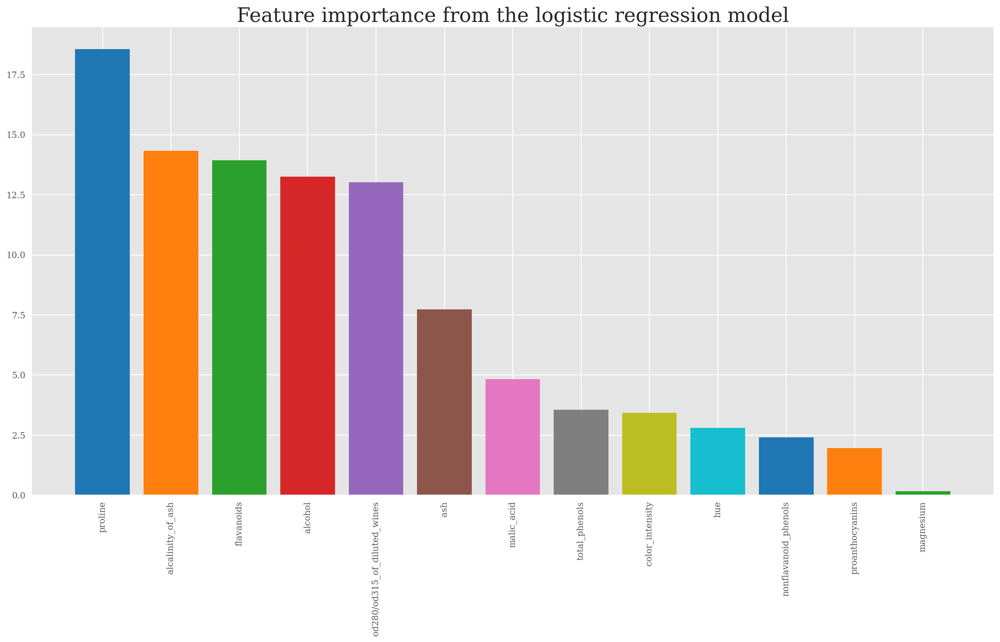

In [22]:
plt.bar( height=df['important (%)'], x=df.feature, 
        color=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', 
               '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf'])
plt.xticks(rotation = 'vertical');
plt.title('Feature importance from the logistic regression model');

#### Shapley Values

Recall that using Shapley values approach is a more general -- and reliable -- way to determine feature importances for a supervised learning model. Let us, therefore, see what it has to say.

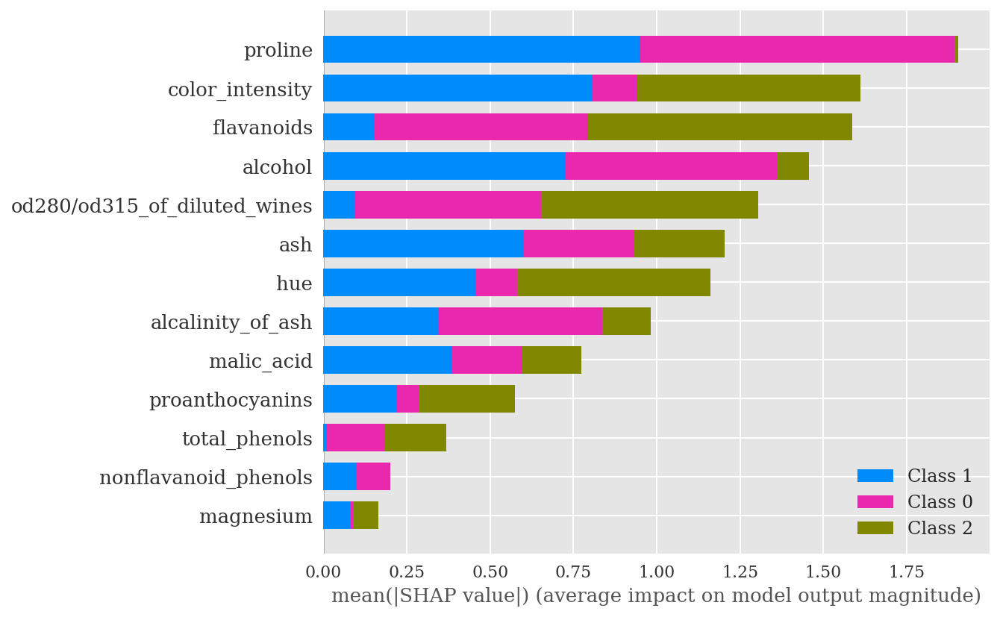

In [23]:
# explain the model's predictions using SHAP
import shap
explainer = shap.LinearExplainer(classifier, X_train)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, feature_names=X_train.columns)